In [1]:
import numpy as np
import pandas as pd 
import altair as alt
import copy
import re 
import ntpath 
from commons import data_processing
from commons import common_objects as co
from commons.DataProcessors import msfragger
from commons.APICallers import uniprot
from venn import venn

alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [68]:
column_colors = alt.Color('column:N',
    scale=alt.Scale(
        domain=["PGC", "RPLC"],
        range=["#D56E3B", "#58728C"]
    ))

In [69]:
files = data_processing.get_files(r'./data/fractions/', exts=['psm.tsv'])

# use msfragger module to process data
msf = None
for file in files:
    m = msfragger.msf_processor([file])

#     # extract fraction and column info
    dirname = ntpath.dirname(file)
    spl = re.split(r'[\\\/]', dirname)
    column, fraction = spl[-2:]
    m.add_special_column('fraction', fraction)
    m.add_special_column('column', column)

    if msf is None:
        msf = m
    else:
        msf.join_processors(m)

# grab data
df = msf.data
msf

MSF Processor constructed on the following data:
./data/fractions/PGC\F1\psm.tsv
./data/fractions/PGC\F2\psm.tsv
./data/fractions/PGC\F3\psm.tsv
./data/fractions/PGC\F4\psm.tsv
./data/fractions/PGC\F5\psm.tsv
./data/fractions/PGC\F6\psm.tsv
./data/fractions/PGC\F7\psm.tsv
./data/fractions/PGC\F8\psm.tsv
./data/fractions/RPLC\F1\psm.tsv
./data/fractions/RPLC\F2\psm.tsv
./data/fractions/RPLC\F3\psm.tsv
./data/fractions/RPLC\F4\psm.tsv
./data/fractions/RPLC\F5\psm.tsv
./data/fractions/RPLC\F6\psm.tsv
./data/fractions/RPLC\F7\psm.tsv
./data/fractions/RPLC\F8\psm.tsv

In [70]:
test = df.modified_peptide.fillna(df.peptide)
df.loc[:, "modified_peptide"] = test
df.intensity

0         0.0
1         0.0
2         0.0
3         0.0
4         0.0
         ... 
192228    0.0
192229    0.0
192230    0.0
192231    0.0
192232    0.0
Name: intensity, Length: 192233, dtype: float64

In [71]:
small = df[["fraction", "column", "modified_peptide", "retention", "intensity"]]
small.loc[:, "rt_min"] = small.retention / 60
small = small.sort_values(["column", "fraction", "modified_peptide", "rt_min"], ascending=[True, True, True, True])

C:\Users\graha\AppData\Local\Temp\ipykernel_12936\3293614337.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  small.loc[:, "rt_min"] = small.retention / 60


In [76]:
import altair_viewer
alt.renderers.enable("default")

RendererRegistry.enable('default')

In [77]:
grouped = small.groupby(["column", "fraction", "modified_peptide"], as_index=False)
mins = grouped.min()
mins = mins.rename(columns={"rt_min":"min_rt"}).drop("retention", axis=1)
maxs = grouped.max()
maxs = maxs.rename(columns={"rt_min":"max_rt"}).drop("retention", axis=1)

mergers = ["column", "fraction", "modified_peptide", "intensity"]

merged = mins.merge(maxs, left_on=mergers, right_on=mergers)
merged.loc[:, "rt_diff"] = merged.max_rt - merged.min_rt

x_axis=co.alt_axis.copy()
x_axis["tickMinStep"] = 1

alt.Chart(merged).mark_bar(clip=True).encode(
    x=alt.X("rt_diff:Q", title="RT Span",
            bin=alt.Bin(step=0.1),
            axis=x_axis,
            scale=alt.Scale(
                domain=[0, 10]
            )),
    y=alt.Y("count():Q", title="",
            axis=co.alt_axis),
    color=column_colors,
).facet("column:N")

alt.FacetChart(...)

In [87]:
alt.Chart(merged[merged.rt_diff<=10]).mark_boxplot(size=50).encode(
    x=alt.X("column:N", title="RT Span",
            axis=x_axis
            ),
    y=alt.Y("rt_diff:Q", title="",
            axis=co.alt_axis),
    color="column:N",
).properties(
    width=150
)

alt.Chart(...)

<AxesSubplot:xlabel='column', ylabel='rt_diff'>

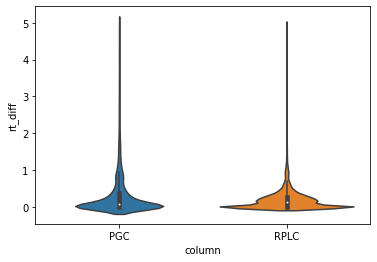

In [90]:
import seaborn as sns

sns.violinplot(
    data=merged[merged.rt_diff<5],
    x="column",
    y="rt_diff"
)